# Polish Parliment Speeches
## Project Overview


## Project Goals

## Plan
1. Data Gathering
- scraping data from https://www.sejm.gov.pl/ using BeautifulSoup
2. Data cleaning and preprocessing
- Preprocessing pdf files using XXX libraries
- Getting only actual speeches
- Dividing text into speeches and speakers
- Scraping and adding additional information (such as speakers political party)
3. Exploratory Data Analysis
- Genral info
- Top Speakers
- Speech Length
4. Tokenization
- Tokenization and lemmatization using spaCy
- WordCloud
5. Topic Modeling
- Tfidf Vectorizer + Kmeans Clustering
- LDA + gensim






# Exploratory Data Analysis



## Understanding the data
### Speakers
- how many speakers
- top speakers
- any errors?
### Speeches
- length of speeches
- how many speeches per meeting/date
- group by date/meeting and topic modeling
- short speeches/ remove from topic modeling?
- word clouds per meeting/per party
- sentiment analysis?
- wtrącenia ()
- okrzyki !
### Data
- day of the week
### Partia
- check errors
- check if is none what speakers


In [ ]:
!pip install gensim

In [331]:
# Import Libraries
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import requests
import json
import string
from collections import Counter
import pickle

# nltk + word cloud
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from wordcloud import WordCloud

#sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.base import TransformerMixin
from sklearn.pipeline import Pipeline

# spaCy
import spacy
from spacy.lang.pl.stop_words import STOP_WORDS
from spacy.lang.pl import Polish

#Gensim
import gensim
import gensim.corpora as corpora
from gensim.models import TfidfModel
# from gensim.utils import CoherenceModel

#vis
import pyLDAvis
import pyLDAvis.gensim_models

import warnings
warnings.filterwarnings('ignore')

In [159]:
# Download spacy models
!python -m spacy download pl_core_news_md

nltk.download('punkt')

# Setting plot style
plt.style.use('fivethirtyeight')

     ---------------------------------------- 49.4/49.4 MB 4.6 MB/s eta 0:00:00
[+] Download and installation successful
You can now load the package via spacy.load('pl_core_news_md')


You should consider upgrading via the 'C:\Users\agata\OneDrive\Pulpit\Github\Sejm\sejm\Scripts\python.exe -m pip install --upgrade pip' command.


In [146]:
# Load Data
df = pd.read_parquet('./data/speeches.parquet')
df.head()

,meeting,speaker,speech_clean_end_4,full_date,partia
0,01_a_ksiazka_bis.pdf,Marszałek Senior Antoni Macierewicz,Otwieram 1. posiedzenie Sejmu Rzeczypospolite...,2019-11-12,None
1,01_a_ksiazka_bis.pdf,Prezydent Rzeczypospolitej Polskiej Andrzej Duda,Drodzy Rodacy! Wielce Szanowny Panie Marszałk...,2019-11-12,None
2,01_a_ksiazka_bis.pdf,Marszałek Senior Antoni Macierewicz,Bardzo dziękuję panu prezydentowi za tak isto...,2019-11-12,None
3,01_a_ksiazka_bis.pdf,Poseł Antoni Macierewicz,Tak mi dopomóż Bóg.,2019-11-12,PIS
4,01_a_ksiazka_bis.pdf,Poseł Daniel Milewski,Poseł Antoni Macierewicz.,2019-11-12,PIS


In [147]:
# Change the name of columns
df.columns = ['meeting', 'speaker', 'speech', 'date', 'party']

In [148]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53616 entries, 0 to 53643
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   meeting  53616 non-null  object
 1   speaker  53616 non-null  object
 2   speech   53616 non-null  object
 3   date     53616 non-null  object
 4   party    23959 non-null  object
dtypes: object(5)
memory usage: 2.5+ MB


In [149]:
# Check for missing data
df.isna().sum()

meeting        0
speaker        0
speech         0
date           0
party      29657
dtype: int64

In [150]:
# Check number of meetings
df['meeting'].nunique()

127

### Speakers

In [192]:
# Top Speakers
df['speaker'].value_counts().head()

Wicemarszałek Małgorzata Gosiewska         5434
Wicemarszałek Małgorzata Kidawa-Błońska    4754
Wicemarszałek Włodzimierz Czarzasty        4490
Wicemarszałek Ryszard Terlecki             4376
Wicemarszałek Piotr Zgorzelski             4269
Name: speaker, dtype: int64

- In Poland 460 Posłów w sejmie

In [152]:
# Numer of unique Speakers
df['speaker'].nunique()

875

In [191]:
# Check of non-"Poseł" speakers
df['speaker'][df['speaker'].apply(lambda x: 'Poseł' not in x)].value_counts().sample(5)

Prezes Rady Ministrów Mateusz Morawiecki                               93
Pani Hanna Elżanowska                                                   1
Sekretarz Stanu W Kancelarii Prezesa Rady Ministrów Piotr Naimski       9
Sekretarz Stanu W Ministerstwie Zdrowia Waldemar Kraska                59
Wicemarszałek Ryszard Terlecki                                       4376
Name: speaker, dtype: int64

In [154]:
# This fuction will group speakers into 3 groups "Poseł", "Marszałek/Wice" and "Other"
def speaker_group(x):
    if 'Poseł' in x:
        y = 'Poseł'
    elif 'Marszałek' in x:
        y = 'Marszałek/Wicemarszałek'
    elif 'Wicemarszałek' in x:
        y = 'Marszałek/Wicemarszałek'
    else:
        y = 'Other'
    return y

In [155]:
df['speaker_group'] = df['speaker'].apply(speaker_group)

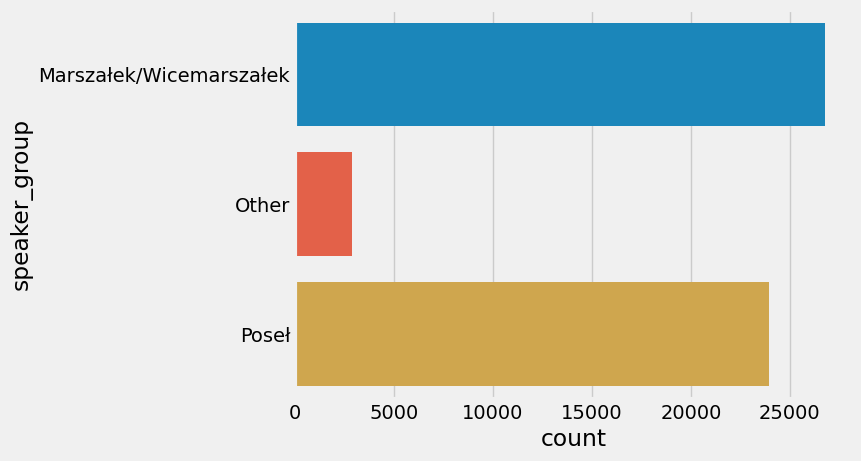

In [156]:
sns.countplot(data = df, y='speaker_group')
plt.show()

In [157]:
# Check if all of the 'Poseł' has pary assigned
df[df['speaker_group'] == 'Poseł']['party'].isna().sum()

0

In [158]:
# Poseł's of which party has the most speeches
df[df['speaker_group'] == 'Poseł']['party'].value_counts()

KO                7765
PIS               5852
Lewica            4436
PSL               2014
Konfederacja      1847
Polska 2050       1502
Socjalistyczna     148
Kukiz              147
Polskie Sprawy     139
Gowin               68
Niezrzeszeni        41
Name: party, dtype: int64

In [212]:
# Top Poseł Speaker in terms of number of speeches
df[df['speaker_group'] == 'Poseł']['speaker'].value_counts().head()

Poseł Mirosław Suchoń        662
Poseł Jan Szopiński          592
Poseł Grzegorz Braun         427
Poseł Tadeusz Tomaszewski    317
Poseł Krystyna Skowrońska    317
Name: speaker, dtype: int64

## Speeches

In [160]:
def remove_mult_spaces(text):
    text = text.strip()
    while "   " in text:
        text = text.replace("  ", " ")
    return text

In [161]:
df['speech'] = df['speech'].apply(remove_mult_spaces)

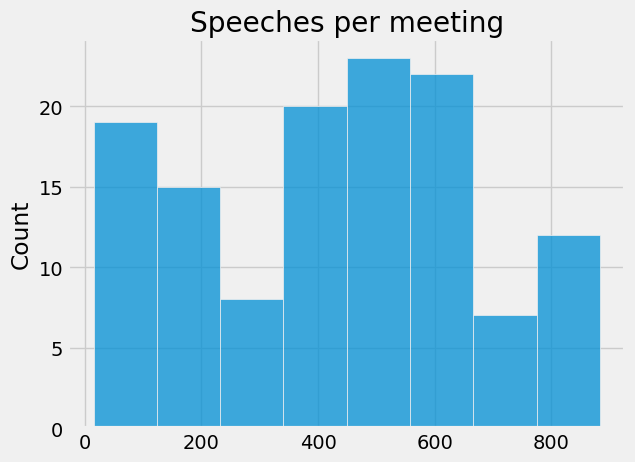

In [162]:
# Speeches per meeting
sns.histplot(df.groupby('date')['speech'].count().values)
plt.title('Speeches per meeting')
plt.show()

In [163]:
df.groupby('date')['speech'].count().sort_values(ascending=False)

date
2021-04-14    883
2021-09-30    879
2022-01-12    871
2021-09-16    868
2021-11-16    863
             ... 
2020-03-31     31
2019-11-13     23
2020-11-28     23
2022-04-13     23
2020-10-20     15
Name: speech, Length: 126, dtype: int64

In [164]:
df.groupby('date')['speech'].count().describe()

count    126.000000
mean     425.523810
std      237.586455
min       15.000000
25%      204.000000
50%      462.000000
75%      594.500000
max      883.000000
Name: speech, dtype: float64

#### Comment:
- There are <26, 883> speeches per meeting
- mode/peak/mean ~ 450 speeches
- also smaller peak at short meetings up to 100 speech

### Length of speech (characters)

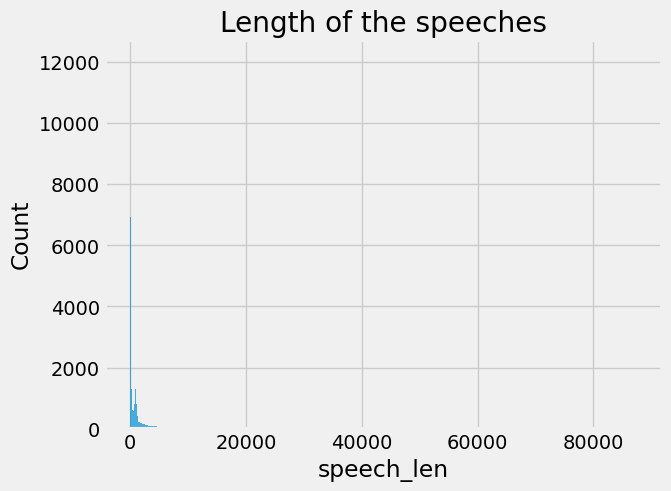

In [165]:
# Length of speech (characters)

df['speech_len'] = df['speech'].apply(lambda x: len(x))

sns.histplot(df['speech_len'])
plt.title('Length of the speeches')
plt.show()

In [166]:
df['speech_len'].describe()

count    53616.000000
mean       903.649582
std       1606.738610
min          0.000000
25%         77.000000
50%        250.000000
75%       1036.000000
max      87436.000000
Name: speech_len, dtype: float64

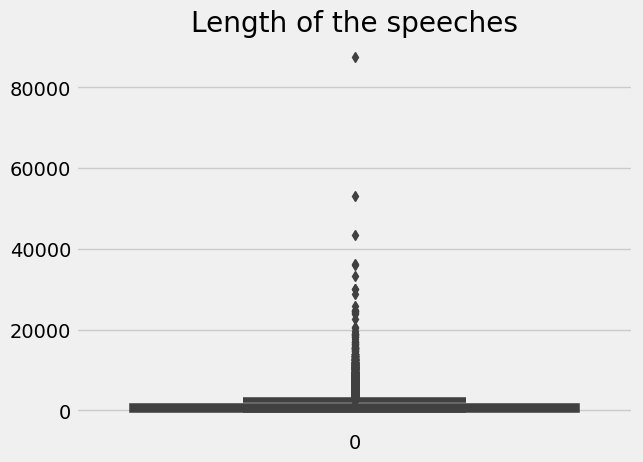

In [167]:
sns.boxplot(df['speech_len'])
plt.title('Length of the speeches')
plt.show()

In [168]:
df['speech_len'].quantile(0.95)

3924.25

#### Comment:
- Length of the speech distribiution is is skewed right
- 95% of speeches are below 4000 characters
- The longest speech has 87.5 k characters

In [169]:
# Length of speeches per party

In [170]:
df.columns

Index(['meeting', 'speaker', 'speech', 'date', 'party', 'speaker_group',
       'speech_len'],
      dtype='object')

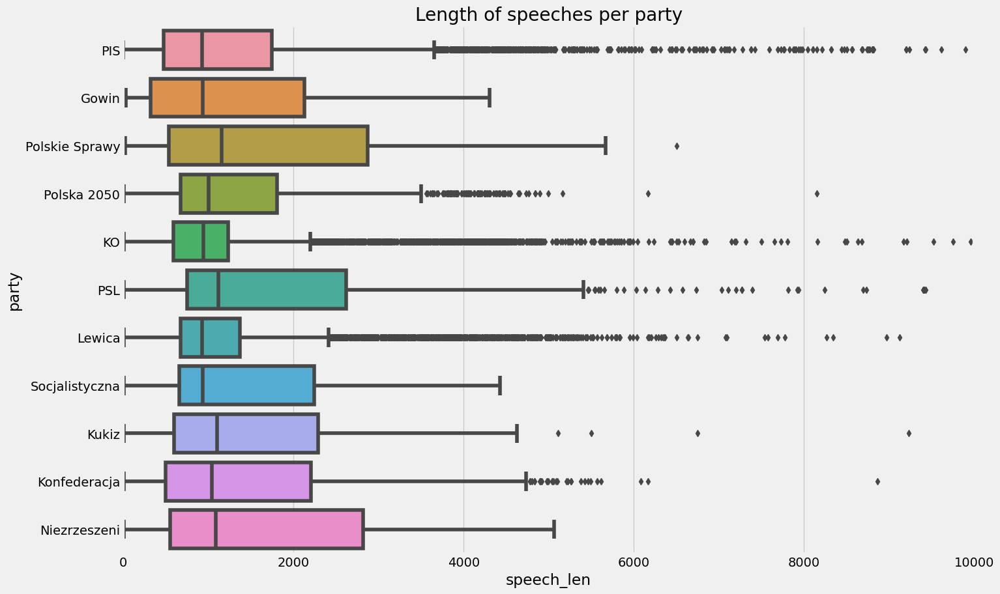

In [319]:
# Distribution of length of Poseł speeches per Party
plt.figure(figsize=(15,10))
sns.boxplot(data = df[df['speaker_group'] == 'Poseł'], x = 'speech_len', y = 'party')
plt.xlim(0,10000)
plt.title("Length of speeches per party")
plt.show()

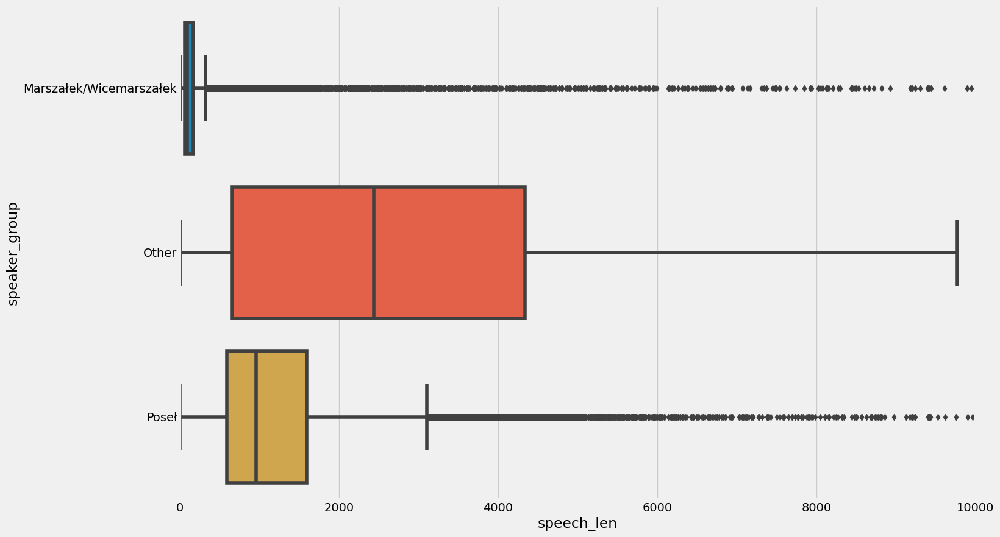

In [217]:
# Distribution of length of speeches per speaker group
plt.figure(figsize=(15,10))
sns.boxplot(data = df, x = 'speech_len', y = 'speaker_group')
plt.xlim(0,10000) # Limiting the scale to better see distribution, few outliers up to 80k speech_len
plt.show()

- As expected Marszałek/Wice, who moderates parliment meetings, have usually very short speeches like "Thank you, Next"
- Than we have 'Poseł' and defienietly the longest speeches comes from "Other" group, who are "guests" in parliments meeting like president or ministers

## Tokenization
- word tokenization
- sent tokenization
-  Bag of Words

### SpaCy
- Get doc object for each speech
- get list of tokens for each speech
- 

In [173]:
# Loading polish medium model
nlp = spacy.load("pl_core_news_md", disable=['parser', 'ner'])  # tu można deactivate zorbić nera, parsera

In [174]:
# Creating doc object for each speech
speeches = df['speech'].to_list()
doc_speeches = nlp.pipe(speeches)
doc_speeches = list(doc_speeches)
df['speeches_doc'] = doc_speeches

In [177]:
# Polish stopwords
url = 'https://raw.githubusercontent.com/stopwords-iso/stopwords-pl/master/stopwords-pl.json'
resp = requests.get(url)
stop_words = resp.text
stop_words = stop_words.replace('"','').replace('[','').replace(']','').split(',')

# Punctuation
punctuation = set(string.punctuation+'–'+'...')
punctuation.add('...')

In [179]:
def spacy_tokenizer(text):
    mytokens = nlp(text)
    
    # Lemmatizing each token and converting each token into lowercase
    mytokens = [word.lemma_.lower().strip() if word.lemma_ != "-PRON-" else word.lower_ for word in mytokens]

    # Removing stop words
    mytokens = [word for word in mytokens if word not in stop_words and word not in punctuation]
    
    mytokens = [word for word in mytokens if len(word) > 0]
    
    return mytokens

In [180]:
df['lemma_words'] = df['speeches_doc'].apply(spacy_tokenizer)

In [322]:
# Saving data for streamlit
# df[['meeting', 'speaker', 'speech', 'date', 'party', 'speaker_group',
#        'speech_len', 'lemma_words']].to_parquet('speeches_lemma.parquet')

### WordCLoud

In [181]:
def generate_personal_cloud(speaker):
    words = df[df['speaker'] == speaker]['lemma_words'].sum()
    words = ' '.join(words)
    wordcloud = WordCloud(width = 1000, height = 1000, 
                background_color ='white', 
                stopwords = add_stop_words,     # mask = pic, 
                min_font_size = 10).generate(braun_words)

    # Create a figure of the generated cloud
    plt.imshow(wordcloud, interpolation='bilinear')  
    plt.axis('off')
    # Display the figure
    plt.show()

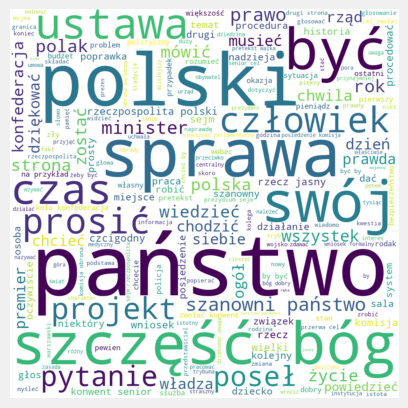

In [182]:
generate_personal_cloud('Poseł Grzegorz Braun')

In [ ]:
# 'Poseł Mirosław Suchoń', 'Poseł Janusz Korwin-Mikke'

In [41]:
korwin_words = df[df['speaker'] == 'Poseł Janusz Korwin-Mikke']['lemma_words'].sum()
korwin_words = ' '.join(korwin_words)

In [42]:
add_stop_words = ['marszałek', 'izbo', 'izba', 'zatem', 'wysoki', 'mieć', 'móc']

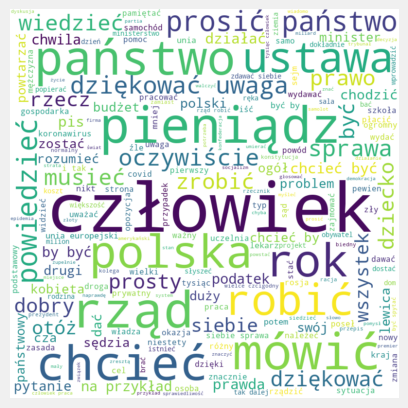

In [45]:
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = add_stop_words,     # mask = pic, 
                min_font_size = 10).generate(korwin_words)

# Create a figure of the generated cloud
plt.imshow(wordcloud, interpolation='bilinear')  
plt.axis('off')
# Display the figure
plt.show()

# Topic modeling
## Tfidf and KMeans Clustering
I will merge all the speeches for each meeting, create bag of words and tfidf

In [185]:
df_meeting = df.groupby('date')['speech'].sum().to_frame()
df_meeting = df_meeting.reset_index()

In [186]:
df_meeting

,date,speech
0,2019-11-12,Otwieram 1. posiedzenie Sejmu Rzeczypospolitej...
1,2019-11-13,"Proszę państwa, wznawiam posiedzenie. Wysoka I..."
2,2019-11-19,"Panie I panowie posłowie, bardzo proszę o zajm..."
3,2019-11-21,Dzień dobry państwu. Wznawiam posiedzenie. Na ...
4,2019-12-12,Otwieram posiedzenie. Proszę państwa posłów o...
...,...,...
121,2022-03-23,Otwieram posiedzenie. Na sekretarzy dzisiejszy...
122,2022-03-24,Wznawiam posiedzenie. Na sekretarzy dzisiejszy...
123,2022-04-06,Otwieram posiedzenie. Na sekretarzy dzisiejszy...
124,2022-04-07,Wznawiam posiedzenie. Na sekretarzy dzisiejszy...


In [208]:
tfidf_vector = TfidfVectorizer(tokenizer = spacy_tokenizer,
                              max_features=100,
                              max_df=0.8,
                              min_df=5,
                              ngram_range = (1,1)
                              )

In [209]:
vectors = tfidf_vector.fit_transform(df_meeting['speech'])

In [189]:
feature_names = tfidf_vector.get_feature_names()

C:\Users\agata\OneDrive\Pulpit\Github\Sejm\sejm\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [190]:
feature_names 

['2022',
 '2050',
 'akcyza',
 'aktywa',
 'bank',
 'bardzo.bardzo',
 'bardzo.dziękuję',
 'bezwzględny',
 'branża',
 'budynek',
 'cywilny',
 'członkowski',
 'dochodowy',
 'domowy',
 'dotacja',
 'dowód',
 'drogowy',
 'dyrektor',
 'dyrektywa',
 'dziękuję.dziękywać',
 'dług',
 'elektryczny',
 'emeryt',
 'emerytalny',
 'emerytura',
 'emisja',
 'energetyczny',
 'energetyka',
 'euro',
 'funkcjonariusz',
 'gaz',
 'graniczny',
 'grunt',
 'handel',
 'handlowy',
 'inflacja',
 'inspekcja',
 'instytut',
 'inwestycyjny',
 'kampania',
 'kandydat',
 'karny',
 'kierowca',
 'kilometr',
 'klimat',
 'klimatyczny',
 'kolejowy',
 'konsument',
 'konwencja',
 'kopalnia',
 'kredyt',
 'kryterium',
 'las',
 'lek',
 'likwidacja',
 'limit',
 'miejscowość',
 'mieszkanie',
 'mieszkaniowy',
 'mniejszość',
 'modernizacja',
 'morski',
 'nadzwyczajny',
 'nadzór',
 'nauczyciel',
 'naukowy',
 'niemiecki',
 'niepełnosprawny',
 'nieruchomość',
 'obrót',
 'obwodnica',
 'odbudowa',
 'odpad',
 'odrzucenie',
 'opłata',
 'ośrodek

In [194]:
dense = vectors.todense()
denselist = dense.tolist()

all_keywords = []

for description in denselist:
    x=0
    keywords = []
    for word in description:
        if word > 0:
            keywords.append(feature_names[x])
        x += 1
    all_keywords.append(keywords)

In [195]:
all_keywords[0]

['bank',
 'bezwzględny',
 'dowód',
 'dyrektor',
 'emerytura',
 'energetyczny',
 'instytut',
 'kampania',
 'kandydat',
 'karny',
 'kolejowy',
 'kredyt',
 'kryterium',
 'likwidacja',
 'miejscowość',
 'mniejszość',
 'nauczyciel',
 'niemiecki',
 'odbudowa',
 'podatkowy',
 'profesor',
 'prąd',
 'reforma',
 'rocznica',
 'rosnąć',
 'rosyjski',
 'skarbowy',
 'strategiczny',
 'strefa',
 'sędzia',
 'telewizja',
 'test',
 'uczelnia',
 'ukraina',
 'vat',
 'wojsko',
 'wyrok',
 'zus',
 'ład',
 'żołnierz',
 'żywność']

In [207]:
# CLusering
n_cluster = 3

model = KMeans(n_clusters = n_cluster, init="k-means++", max_iter=100, n_init=1)

model.fit(vectors)

order_centroids = model.cluster_centers_.argsort()[:,::-1]
terms = tfidf_vector.get_feature_names()

for i in range(n_cluster):
    print(f'Cluster {i}')
    for ind in order_centroids[i, :10]:
        print(terms[ind])
    print('\n\n')

Cluster 0
emerytura
energetyczny
kolejowy
mieszkanie
inflacja
zwierzę
opłata
emeryt
gaz
vat



Cluster 1
odrzucenie
bezwzględny
ukraina
2022
rosyjski
sędzia
nauczyciel
ład
gaz
wojsko



Cluster 2
mniejszość
rzecznik
tarcza
test
sędzia
odbudowa
przemoc
zus
pielęgniarka
bank





In [210]:
labels = pd.Series(model.labels_)
df_meeting['cluster_labels'] = labels

In [211]:
df_meeting['cluster_labels'].value_counts()

2    47
0    47
1    32
Name: cluster_labels, dtype: int64

## Gensim
- BoW
- using word2vec

In [224]:
def lemmatization(texts, allowed_postags=["NOUN", "ADJ", "VERB", "ADV"]):
    texts_out = []
    for text in texts:
        doc = nlp(text)
        new_text = []
        for token in doc:
            if token.pos_ in allowed_postags:
                new_text.append(token.lemma_)
        final = " ".join(new_text)
        texts_out.append(final)
    return texts_out

lemmatized_texts = lemmatization(df_meeting['speech'])

In [236]:
print(f'Type of lemmatized_texts: {type(lemmatized_texts)}, length of lemmatized_texts {len(lemmatized_texts)}')

Type of lemmatized_texts: <class 'list'>, length of lemmatized_texts 126


In [231]:
type(lemmatized_texts[0]) # contains of 126 strings one per meetinf

str

In [325]:
df_meeting['lemmatized_text'] = lemmatized_texts

In [329]:
df_meeting[['date', 'lemmatized_text']].to_parquet('lemma_meetings.parquet')

In [232]:
lemmatized_texts[0][:100]

'otwierać posiedzenie sejm Polski IX kadencja Szanowni państwo serdecznie witać przybyły uroczystość '

In [323]:
lemmatized_texts

['otwierać posiedzenie sejm Polski IX kadencja Szanowni państwo serdecznie witać przybyły uroczystość prezydent Polski pan prezes rada minister pan członek rada minister marszałek sejm I senat ubiegły kadencja korpus dyplomatyczny wraz dziekan nuncjusz apostolski Pennacchio witać duchowieństwo przewodniczący konferencja Episkopat Eminencją księdz arcybiskup witać członek polski rada Ekumeniczny przedstawiciel inny Kościół I związek wyznaniowy witać dowódca sił Zbrojny polski szef sztab generalny generał witać pani pan wybrać poseł sejm Polski gość obecność uświetniać inauguracja posiedzenie sejm IX kadencja Szanowni państwo dzień 8 listopad zemrzeć nauczyciel samorządowiec burmistrz poseł sejm VII VIII kadencja Uczcijmy chwila cisza pamięć pamięć zmarły ostatnio parlamentarzysta służyć ojczyzna dziękować bardzo bardzo prosić prezydent Polski pan wygłoszenie orędzia 1 posiedzenie sejm IX kadencja bardzo prosić pan prezydent drodzy Rodak wielce szanowny pan marszałku Szanowni państwo pop

In [226]:
def gen_words(texts):
    final = []
    for text in texts:
        new = gensim.utils.simple_preprocess(text, deacc=True)
        final.append(new)
    return final

data_words = gen_words(lemmatized_texts)

In [235]:
print(f'Type oof data_words: {type(data_words)}, length of data_words {len(data_words)}')

Type oof data_words: <class 'list'>, length of data_words 126


In [237]:
type(data_words[0]) # Now instead of string per each meeting we have list of words

list

In [239]:
data_words[0][:10]

['otwierac',
 'posiedzenie',
 'sejm',
 'polski',
 'ix',
 'kadencja',
 'szanowni',
 'panstwo',
 'serdecznie',
 'witac']

In [310]:
black_list = ['ministrze', 'przycisk', 'przeciw' , 'wstrzymac', 'zachecic', 'głosujemy', 'nacisnac', 'głosowac',
             'bezwzgledny', 'poprawka', 'zechciec', 'sejm', 'tak', 'dopomoz', 'slubuje', 'ślubuję', 'senat', 'uchwała', 'uzyskac', 'proponowac']

In [311]:
final_words_full = []
for doc in data_words:
    final_words_doc = [word for word in doc if word not in black_list and word.isdigit() == False]
    final_words_full.append(final_words_doc)

In [291]:
# # Bigrams and Trigrams
# bigram_phrases = gensim.models.Phrases(data_words, min_count=5, threshold=100)
# trigram_phrases = gensim.models.Phrases(bigram_phrases[data_words], threshold=100)

# bigram = gensim.models.phrases.Phraser(bigram_phrases)
# trigram = gensim.models.phrases.Phraser(trigram_phrases)

# def make_bigrams(texts):
#     return([bigram[doc] for doc in texts])

# def make_trigrams(texts):
#     return ([trigram[bigram[doc]] for doc in texts])

# data_bigrams = make_bigrams(data_words)
# data_bigrams_trigrams = make_trigrams(data_bigrams)

# print (data_bigrams_trigrams[0][0:20])

['otwierac', 'posiedzenie', 'sejm', 'polski', 'ix_kadencja', 'szanowni', 'panstwo', 'serdecznie', 'witac', 'przybyły', 'uroczystosc', 'prezydent', 'polski', 'pan', 'prezes', 'rada', 'minister', 'pan', 'członek', 'rada']


In [312]:
# Bigrams and Trigrams  - Filteresd words with blacklist
bigram_phrases = gensim.models.Phrases(final_words_full, min_count=5, threshold=100)
trigram_phrases = gensim.models.Phrases(bigram_phrases[data_words], threshold=100)

bigram = gensim.models.phrases.Phraser(bigram_phrases)
trigram = gensim.models.phrases.Phraser(trigram_phrases)

def make_bigrams(texts):
    return([bigram[doc] for doc in texts])

def make_trigrams(texts):
    return ([trigram[bigram[doc]] for doc in texts])

data_bigrams = make_bigrams(final_words_full)
data_bigrams_trigrams = make_trigrams(data_bigrams)

print (data_bigrams_trigrams[0][0:20])

['otwierac', 'posiedzenie', 'polski', 'ix_kadencja', 'szanowni', 'panstwo', 'serdecznie', 'witac', 'przybyły', 'uroczystosc', 'prezydent', 'polski', 'pan', 'prezes', 'rada', 'minister', 'pan', 'członek', 'rada', 'minister']


In [270]:
print (data_bigrams_trigrams[0][110:])

['marszałku', 'szanowni', 'panstwo', 'poprzedni', 'wczesniejszych', 'kadencja', 'wielce_szanowny', 'pan', 'posłanka', 'pan', 'wielce_szanowny', 'pan', 'premier', 'szanowni', 'panstwo', 'ministrowie', 'ekscelencja', 'czcigodny', 'dziekanie', 'korpus_dyplomatyczny', 'wraz', 'ekscelencj', 'przedstawiciel', 'korpus_dyplomatyczny', 'ambasadora', 'konsula', 'zagraniczny', 'gosc', 'kraj', 'polski', 'eminencja', 'ekscelencja', 'ksieza', 'biskupi', 'osoba', 'stan', 'duchownego', 'obecny', 'sala', 'słuchac', 'wystapienie', 'dostojni', 'przybyc', 'goscie', 'przedstawiciel', 'instytucja', 'panstwowy', 'samorzadowy', 'wielce', 'szanowni', 'panstwo', 'niezwykły', 'zaszczyt', 'moc', 'otwierac', 'dzisiaj', 'wraz', 'panstwo', 'pierwszy', 'posiedzenie', 'sejm', 'polski', 'ix_kadencja_sejm', 'wolny_niepodległy', 'suwerenny', 'okres', 'szczegolny', 'listopad', 'obchode', 'rocznica_odzyskac_niepodległosc', 'pamietny', 'tak', 'rok', 'szczegolny', 'bedacym', 'rok', 'powstan', 'slaski', 'przypadac', 'rok', 'r

In [330]:
type(data_bigrams_trigrams)

list

In [333]:
len(data_bigrams_trigrams)

126

In [335]:
df_meeting['data_bigram_trigrams'] = data_bigrams_trigrams

In [337]:
# Saving data for streamlit
# df_meeting[['date', 'data_bigram_trigrams']].to_parquet('bigrams_gensim.parquet')

In [276]:
bow

[(4, 2),
 (49, 25),
 (56, 4),
 (62, 2),
 (71, 1),
 (78, 1),
 (83, 1),
 (86, 1),
 (94, 5),
 (95, 35),
 (99, 1),
 (101, 3),
 (104, 5),
 (105, 3),
 (113, 1),
 (115, 14),
 (118, 5),
 (122, 5),
 (123, 2),
 (135, 1),
 (143, 2),
 (149, 1),
 (151, 1),
 (162, 1),
 (163, 2),
 (166, 1),
 (177, 4),
 (181, 3),
 (183, 1),
 (192, 1),
 (198, 2),
 (202, 2),
 (209, 2),
 (216, 1),
 (224, 2),
 (244, 1),
 (255, 1),
 (256, 1),
 (257, 2),
 (263, 1),
 (264, 1),
 (286, 15),
 (288, 2),
 (295, 13),
 (296, 1),
 (319, 1),
 (331, 2),
 (336, 1),
 (363, 2),
 (402, 1),
 (403, 1),
 (406, 9),
 (407, 6),
 (410, 1),
 (437, 2),
 (441, 1),
 (445, 1),
 (448, 3),
 (454, 1),
 (465, 5),
 (466, 3),
 (472, 1),
 (473, 1),
 (485, 1),
 (504, 5),
 (512, 1),
 (513, 1),
 (517, 1),
 (519, 2),
 (526, 1),
 (529, 1),
 (531, 29),
 (540, 1),
 (546, 2),
 (568, 1),
 (572, 2),
 (575, 3),
 (578, 1),
 (617, 2),
 (621, 1),
 (626, 1),
 (666, 2),
 (669, 8),
 (677, 2),
 (682, 1),
 (686, 1),
 (690, 1),
 (702, 9),
 (714, 1),
 (715, 2),
 (719, 5),
 (720

In [240]:
id2word = corpora.Dictionary(data_words)

corpus = []
for text in data_words:
    new = id2word.doc2bow(text)
    corpus.append(new)

word = id2word[[0][:1][0]]
print(word)

absolutnie


In [242]:
len(id2word)

72062

In [259]:
id2word[7200]     # all words that appears in our data (72 062 words)

'waszyngtonski'

In [249]:
print(f'Type of corpus: {type(corpus)}, length of corpus {len(corpus)}')

Type oof corpus: <class 'list'>, length of corpus 126


In [261]:
corpus[0][:10]    # One tuple for each word, first is index, than the numbers states how many times occured

[(0, 1),
 (1, 2),
 (2, 2),
 (3, 1),
 (4, 6),
 (5, 1),
 (6, 1),
 (7, 2),
 (8, 1),
 (9, 1)]

In [313]:
#TF-IDF REMOVAL
id2word = corpora.Dictionary(data_bigrams_trigrams)

texts = data_bigrams_trigrams

corpus = [id2word.doc2bow(text) for text in texts]
# print (corpus[0][0:20])

tfidf = TfidfModel(corpus, id2word=id2word)

low_value = 0.03
words  = []
words_missing_in_tfidf = []
for i in range(0, len(corpus)):
    bow = corpus[i]
    low_value_words = [] #reinitialize to be safe. You can skip this.
    tfidf_ids = [id for id, value in tfidf[bow]]
    bow_ids = [id for id, value in bow]
    low_value_words = [id for id, value in tfidf[bow] if value < low_value]
    drops = low_value_words+words_missing_in_tfidf
    for item in drops:
        words.append(id2word[item])
    words_missing_in_tfidf = [id for id in bow_ids if id not in tfidf_ids] # The words with tf-idf socre 0 will be missing

    new_bow = [b for b in bow if b[0] not in low_value_words and b[0] not in words_missing_in_tfidf]
    corpus[i] = new_bow

In [316]:
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=7,
                                           random_state=42,
                                           update_every=1,
                                           chunksize=100, # 50
                                           passes=10,
                                           alpha="auto")

In [317]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model,corpus,id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.015371 -0.114701       1        1  21.427192
0      0.283201  0.037850       2        1  19.374715
3     -0.000791 -0.088719       3        1  14.653394
1     -0.059934  0.066023       4        1  14.114620
6     -0.052764 -0.077247       5        1  11.638623
5     -0.073550  0.222658       6        1  11.225730
2     -0.080790 -0.045864       7        1   7.565726, topic_info=                     Term         Freq        Total Category  logprob  loglift
88                 budzet  2012.000000  2012.000000  Default  30.0000  30.0000
103                  cena  1397.000000  1397.000000  Default  29.0000  29.0000
277               dziecko  1591.000000  1591.000000  Default  28.0000  28.0000
1520               sedzia   799.000000   799.000000  Default  27.0000  27.0000
6861               społka   783.000000   783.000000  Default  26.0000  26.0000
...                   ...          ...          ...      ...      ...      ...
10258  wniosek_mniejszosc    46.232812   131.100546   Topic7  -5.7045   1.5393
1448             rosyjski    57.002513   330.341803   Topic7  -5.4951   0.8245
8803              zywnosc    47.354593   285.898719   Topic7  -5.6805   0.7836
7402             uchodzca    50.669331   566.644500   Topic7  -5.6129   0.1671
7705               wegiel    44.351302   217.934819   Topic7  -5.7461   0.9895

[445 rows x 6 columns], token_table=       Topic      Freq     Term
term                           
30133      3  0.279818  aborcja
30133      4  0.675658  aborcja
30133      5  0.040949  aborcja
7          1  0.032344  agencja
7          3  0.965347  agencja
...      ...       ...      ...
57045      2  0.685657     ładu
57045      4  0.037570     ładu
57045      5  0.042267     ładu
57045      6  0.197244     ładu
43373      7  0.986939   ławnik

[720 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 1, 4, 2, 7, 6, 3])

In [280]:
lda_model[corpus[50]]

[(6, 0.99979067)]

In [274]:
lda_model

### nltk/old method

In [272]:
x = Counter(df_meeting['lemma_words'][2])
x.most_common()

[('poseł', 664),
 ('mieć', 636),
 ('rok', 627),
 ('premier', 585),
 ('państwo', 554),
 ('dziękować', 537),
 ('polska', 403),
 ('prosić', 379),
 ('rząd', 377),
 ('polski', 368),
 ('mówić', 311),
 ('wysoki', 302),
 ('…', 291),
 ('marszałek', 262),
 ('osoba', 241),
 ('pytanie', 231),
 ('projekt', 228),
 ('izbo', 224),
 ('prawo', 221),
 ('program', 208),
 ('powiedzieć', 207),
 ('fundusz', 207),
 ('móc', 206),
 ('ustawa', 204),
 ('polak', 198),
 ('swój', 187),
 ('sprawa', 181),
 ('obywatelski', 179),
 ('chcieć', 174),
 ('koalicja', 162),
 ('sprawiedliwość', 158),
 ('wielki', 156),
 ('minister', 153),
 ('4', 151),
 ('złoty', 150),
 ('podatek', 148),
 ('czas', 145),
 ('zostać', 142),
 ('europejski', 140),
 ('pieniądz', 138),
 ('polityka', 137),
 ('sejm', 134),
 ('kraj', 132),
 ('głos', 130),
 ('społeczny', 130),
 ('tysiąc', 130),
 ('dobry', 129),
 ('miliard', 126),
 ('chodzić', 124),
 ('bezpieczeństwo', 120),
 ('pierwszy', 119),
 ('exposé', 118),
 ('wszystek', 116),
 ('zdrowie', 115),
 ('rozw

In [156]:
def clean_text(text):
    text = text.lower()
    text = "".join([ch for ch in text if ch not in punctuation])
    text = "".join([i for i in text if not i.isdigit()])
    while "   " in text:
        text = text.replace("  ", " ")
    final = []
    for word in text.split():
        if word not in stop_words:
            final.append(word)
    final_text = " ".join(final)
    return final_text

In [171]:
remove_mult_spaces(df['speech'][0])

'Otwieram 1. posiedzenie Sejmu Rzeczypospolitej Polskiej IX kadencji. Szanowni Państwo! Serdecznie witam przybyłych na naszą uroczystość: prezydenta Rzeczypospolitej Polskiej pana Andrzeja Dudę , prezesa Rady Ministrów pana Mateusza Morawieckiego oraz członków Rady Ministrów , marszałków Sejmu I Senatu ubiegłych kadencji , korpus dyplomatyczny wraz z jego dziekanem nuncjuszem apostolskim W Polsce Salvatore Pennacchio. Witam duchowieństwo z przewodniczącym Konferencji Episkopatu Polski Jego Eminencją księdzem arcybiskupem Stanisławem Gądeckim. Witam członków Polskiej Rady Ekumenicznej oraz wszystkich przedstawicieli innych Kościołów I związków wyznaniowych. Witam dowódców Sił Zbrojnych Rzeczypospolitej Polskiej z szefem Sztabu Generalnego generałem Rajmundem Andrzejczakiem. Witam wszystkie panie I panów wybranych na posłów Sejmu Rzeczypospolitej Polskiej oraz wszystkich gości, którzy swoją obecnością uświetniają inaugurację 1. posiedzenia Sejmu IX kadencji. Szanowni Państwo! W dniu 8 li